## **Parameter Definition**

In [1]:
# import libraries
import numpy as np
import math
from matplotlib import pyplot as plt
from scipy.optimize import fsolve
intersection_point = (0, 0)  # default value

# @ parameters for blades
# cutting speed of blade
v_cut_2 = 6 # m2/hr
# life time of blade
a_max_cut_blade = 30 # m^2 for 6-8 m2/hr or 15 m^2 for 3-4 m2/hr
span_blade = a_max_cut_blade/v_cut_2  # = 5hr 
# diameter of blade
d_blade = 0.8 # m (600 mm … 1,600 mm)
# thickness of blade
t_blade = 2.2/1000 # m
# weight of blade
w_blade = np.pi * np.square(d_blade/2) * t_blade * 7800 # kg (steel density 7800 kg/m3)

# @ parameters for materials 
# density of materials
rho_light_reinforced_concrete = 2500
rho_hard_reinforced_concrete = 2770
rho_brick =900
rho_concrete = 2150 # kg/m3 lean concrete

# @ CO2 emission of materials
light_reinforced_concrete_emission = 0.204 # kgCO2eq/kg from KBOB for Switzerland
hard_reinforced_concrete_emission = 0.358 # kgCO2eq/kg from KBOB for Switzerland
brick_emission = 0.267 # kgCO2eq/kg from KBOB for Switzerland
concrete_emission = 0.063 # kgCO2eq/kg from KBOB for Switzerland
steel_CO2_emission = 2.79 # kgCO2eq/kg from KBOB 06.010 Sheet steel, blank, hot rolled, uncoated, thickness 3 mm
electricity_CO2_emission = 0.01057 # 0.01057285 # kgCO2eq/kWh from KBOB for Switzerland
diamond_blade_CO2_emission = 334.123/200/35 * span_blade * 80 # kgCO2eq/kg # reference: https://ieeexplore.ieee.org/document/10021341
machine_CO2_emission = 1.52 # kgCO2eq/kg assumed average emission for machine production using steel

# @ wall saw parameters
# power = 20 # kW, Hilti wall saw DST 20-CA 
power = 32 # kW, Hilti wall saw DST 20-CA (or 40kVA generator using diesel fuel which is around 32kW)
# weight of machine
w_machine = 32 # kg

# @ parameters for cutting
fast_cut_speed_area = 6 # m2/hour
slow_cut_speed_area = 3 # m2/hour
cutting_speed = 2-(2-0.7)/(15-5)*(12-5) # 1.08m/min @ 12cm depth

# @ dimensional parameters for a concrete beam
cutting_length = beam_width = 0.4 # meters
cutting_depth = beam_depth = 0.4
beam_length = 4  # meters

# @ transportation parameters
distance_factory_b = 100 # km
# the reuse distance is a times the distance from factory to site
a = 1 
distance_a_storage_b_total = a * distance_factory_b # km
# carbon emission of different transportation methods
lorry_CO2_emission = 0.144 # kgCO2eq/tonkm
truck_CO2_emission = 0.183 # kgCO2eq/tonkm, 16-32 ton truck, assuming 8m3 of concrete of 32 ton
# load capacity of lorry or concrete truck
size_truck = 9 # m3
weight_concrete_truck = size_truck * rho_concrete # 19.35 ton
lorry_load_capacity = 12e3 # ton
lorry_space_capacity = 9
# Additional information:
# max cutting depth 73 cm
# guide cut at half power consumption at 4cm depth

## **Function Definition**

In [2]:
# calculate the maximum number of concrete beam to be transported for reuse
def max_concrete_beam(cutting_length,rho):
    v_concrete_beam = cutting_length * beam_width * beam_depth
    weight_concrete_beam = v_concrete_beam * rho
    max_num_concrete_beam = np.minimum(np.floor(lorry_space_capacity / v_concrete_beam),np.floor(lorry_load_capacity / weight_concrete_beam))
    return max_num_concrete_beam

# calculate the total weight of concrete beam to be transported for reuse
def total_weight_concrete_beam(cutting_length, rho):
    v_concrete_beam = cutting_length * beam_width * beam_depth
    weight_concrete_beam = v_concrete_beam * rho
    max_num_concrete_beam = np.minimum(np.floor(lorry_space_capacity / v_concrete_beam),np.floor(lorry_load_capacity / weight_concrete_beam)) #7
    total_weight_concrete_beam = max_num_concrete_beam * weight_concrete_beam
    return total_weight_concrete_beam

# calculate the carbon emission for manufacturing the concrete beam
def manufacturing_cost_beam(carbon_emission, beam_length, beam_width, beam_depth, rho):
    beam_volumne = beam_length * beam_width * beam_depth
    manufacturing_CO2_cost = carbon_emission * beam_volumne * rho
    return manufacturing_CO2_cost

# calculate the carbon emission for manufacturing the concrete wall
def manufacturing_cost_wall(carbon_emission, wall_thickness, wall_width, wall_height, rho):
    wall_volume = wall_thickness * wall_width * wall_height
    manufacturing_CO2_cost = carbon_emission * wall_volume * rho
    return manufacturing_CO2_cost

# calculate the carbon emission for cutting the concrete beam
def cut_impact(electricity_CO2_emission, cutting_time):
    impact_energy = (power * cutting_time) * (electricity_CO2_emission) # impact of electricity consumption 
    impact_blade = diamond_blade_CO2_emission * cutting_time /span_blade
    # impact_blade = (w_blade * cutting_time /span_blade) * steel_CO2_emission + (w_diamond * cutting_time /span_blade) * diamond_CO2_emission# impact of blade production
    impact_machine = w_machine * machine_CO2_emission # impact of machine production
    cut_impact = impact_energy + impact_blade + impact_machine
    return cut_impact

# calculate the cutting time for the concrete beam
def cutting_time_beam(cutting_length, cutting_depth, cut_speed_area):
    cutting_pass = np.ceil(cutting_depth/0.12) * 2 # back and forth cut @12cm depth
    cutting_time_speed = 2 * (cutting_length /cutting_speed * cutting_pass + cutting_length/(cutting_speed/2))/60 # hours # two cuts
    cutting_time_area = 2 * ( cutting_length * cutting_depth/ cut_speed_area * cutting_pass  + cutting_length/(cutting_speed/2)/60)
    return max(cutting_time_speed, cutting_time_area)

# calculate the cutting time for the concrete wall
def cutting_time_wall(wall_width, wall_height, wall_thickness, cut_speed_area):
    cutting_length = 2*(wall_width+wall_height)
    cutting_depth = wall_thickness
    # number of passes
    cutting_pass = np.ceil(cutting_depth/0.12) * 2 # back and forth cut @12cm depth
    # cutting time depending on speed or area
    cutting_time_speed = (cutting_length /cutting_speed * cutting_pass + cutting_length/(cutting_speed/2))/60 # hours 
    cutting_time_area = ( cutting_length * cutting_depth/ cut_speed_area  + cutting_length/(cutting_speed/2)/60)  
    return max(cutting_time_speed, cutting_time_area)

# calculate the carbon emission for transportation of reused concrete beam
def transport_impact_lorry(total_weight_concrete_beam,distance_a_storage_b_total): # assume fully loaded lorry
    transport_impact_lorry = distance_a_storage_b_total * total_weight_concrete_beam/1000 * lorry_CO2_emission
    return transport_impact_lorry

# calculate the carbon emission for transportation of new concrete
def transport_impact_truck(distance_factory_b,weight_concrete_truck):
    transport_impact_truck = distance_factory_b * weight_concrete_truck/1000 * truck_CO2_emission 
    # transport_impact_truck = concrete_truck_transport * truck_CO2_emission
    return transport_impact_truck

In [19]:
# test of cutting concrete beams of length 4m, width 0.4m, depth 0.4m
weight_concrete_beam = beam_length * beam_width * beam_depth * rho_light_reinforced_concrete
max_num_concrete_beam = np.floor(lorry_load_capacity / weight_concrete_beam) 
cutting_time = cutting_time_beam(beam_width, beam_depth, fast_cut_speed_area)
reuse_impact = transport_impact_lorry(weight_concrete_beam,distance_a_storage_b_total)\
            + cut_impact(electricity_CO2_emission, cutting_time) * max_num_concrete_beam 
new_impact = transport_impact_truck(distance_factory_b,weight_concrete_beam) \
        + manufacturing_cost_beam(light_reinforced_concrete_emission, beam_length, beam_width, beam_depth, rho_light_reinforced_concrete) 
reuse_impact, new_impact

(376.6468077993884, 355.68000000000006)

## **Sensitivity Analysis**

In [ ]:
# import libraries
import numpy as np
import math
from SALib.sample import saltelli
from SALib.util import read_param_file

import numpy as np
import math
from scipy.optimize import fsolve
from SALib.sample import sobol
from SALib.analyze import sobol as sobol_analyze
import matplotlib.pyplot as plt

### **Sensitivity Analysis: Exploring the Influence of Transportation Distance, Ratio "a" and cutting lengths on Re-use Environmental Impact Outcomes**

C:\Users\xiongs\AppData\Local\Temp\ipykernel_6804\395648015.py:24: DeprecationWarning:

`salib.sample.saltelli` will be removed in SALib 1.5. Please use `salib.sample.sobol`



First order indices: [0.00577253 0.03170785 0.96784253]
Total order indices: [0.00817187 0.03341294 0.96761139]


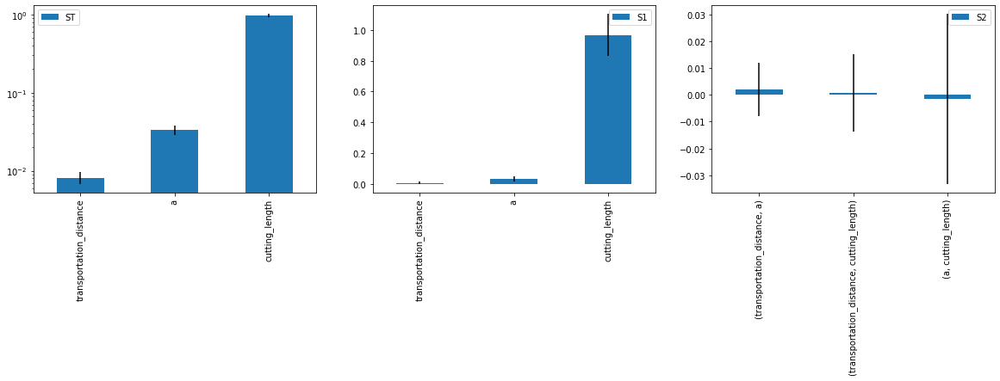

In [14]:
def calculate(transportation_distance, a, cutting_length):
# Calculate reuse impact and new impact for each cutting length
    # Calculate cutting time and other necessary parameters
    cutting_time = cutting_time_beam(cutting_length, cutting_depth, fast_cut_speed_area)
    max_num_concrete_beam = max_concrete_beam(cutting_length,rho_light_reinforced_concrete)
    total_weight_beam = total_weight_concrete_beam(cutting_length, rho_light_reinforced_concrete)
    
    # Calculate reuse impact and new impact
    reuse_impact =  cut_impact(electricity_CO2_emission, cutting_time) * max_num_concrete_beam \
                + transport_impact_lorry(total_weight_beam, a*transportation_distance) 
    new_impact = manufacturing_cost_beam(light_reinforced_concrete_emission, cutting_length, beam_width, beam_depth, rho_light_reinforced_concrete) \
                + transport_impact_truck(transportation_distance, total_weight_beam) 

    return reuse_impact #new_impact

# Define the ranges for the input parameters
problem = {
    'num_vars': 3,
    'names': ['transportation_distance', 'a', 'cutting_length'],
    'bounds': [[50, 100], [0.5, 3], [0.5, 10]]
}

# Generate the samples using the Saltelli sampling method
param_values = saltelli.sample(problem, 1024)
# param_values = sobol.sample(problem, 1024)

# Run the model function and calculate the output for each sample
Y = np.zeros([param_values.shape[0]])
for i, X in enumerate(param_values):
    Y[i] = calculate(*X)
# select valid values not NAN
Y = Y[~np.isnan(Y)]
Y = Y[Y != 0]
# Perform the Sobol sensitivity analysis to calculate the sensitivity indices
Si = sobol_analyze.analyze(problem, Y) #, calc_second_order=True, print_to_console=False)

# Print the sensitivity indices
print('First order indices:', Si['S1'])
print('Total order indices:', Si['ST'])

import matplotlib.pyplot as plt
axes = Si.plot()
axes[0].set_yscale('log')
fig = plt.gcf()  # get current figure
fig.set_size_inches(20, 4)

# plt.tight_layout()
plt.show()


### **Sensitivity Analysis: Exploring the Influence of Transportation Distance and Ratio "a" on Minimum Cutting Length Outcomes**

C:\Users\xiongs\AppData\Local\Temp\ipykernel_6804\2418338208.py:43: DeprecationWarning:

`salib.sample.saltelli` will be removed in SALib 1.5. Please use `salib.sample.sobol`



First order indices: [-0.11309405  0.17631627]
Total order indices: [0.67335806 0.95948579]


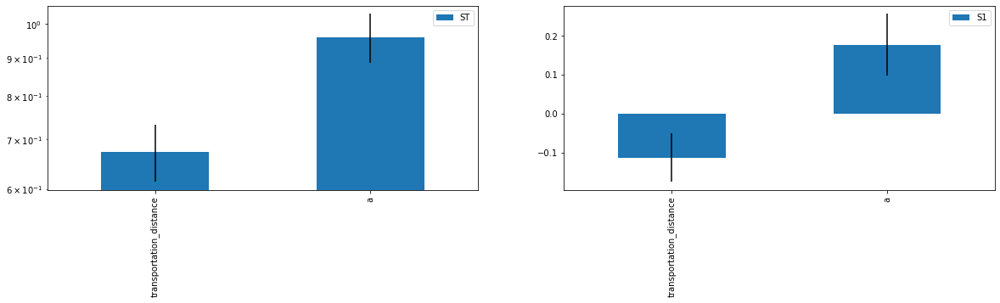

In [18]:


def calculate(transportation_distance, a):
# Calculate reuse impact and new impact for each cutting length
    # Define the range of cutting length
    cutting_length_range = np.linspace(0.5, 10, 100)  # Example range for cutting length

    # Initialize arrays to store the reuse impact and new impact values
    reuse_impact_values = []
    new_impact_values = []
    for cutting_length in cutting_length_range:
        # Calculate cutting time and other necessary parameters
        cutting_time = cutting_time_beam(cutting_length, cutting_depth, fast_cut_speed_area)
        max_num_concrete_beam = max_concrete_beam(cutting_length,rho_light_reinforced_concrete)
        total_weight_beam = total_weight_concrete_beam(cutting_length, rho_light_reinforced_concrete)
        
        # Calculate reuse impact and new impact
        reuse_impact =  cut_impact(electricity_CO2_emission, cutting_time) * max_num_concrete_beam \
                    + transport_impact_lorry(total_weight_beam, a*transportation_distance) 
        new_impact = manufacturing_cost_beam(light_reinforced_concrete_emission, cutting_length, beam_width, beam_depth, rho_light_reinforced_concrete) \
                    + transport_impact_truck(transportation_distance, total_weight_beam) 
        
        # Store the impact values
        reuse_impact_values.append(reuse_impact)
        new_impact_values.append(new_impact)

    # Find the intersection point with tolerance
    tolerance = 1e-5
    intersection_func = lambda x: np.interp(x, cutting_length_range, new_impact_values) - np.interp(x, cutting_length_range, reuse_impact_values)
    intersection, = fsolve(intersection_func, cutting_length_range[0], xtol=tolerance)
    # return value if exist and valid, otherwise break
    if intersection > 0 and intersection < 10:
        return intersection
    else:
        return 0

# Define the ranges for the input parameters
problem = {
    'num_vars': 2,
    'names': ['transportation_distance', 'a'],
    'bounds': [[10, 300], [0.5, 3]]
}

# Generate the samples using the Saltelli sampling method
param_values = saltelli.sample(problem, 1024)
# param_values = sobol.sample(problem, 1024)

# Run the model function and calculate the output for each sample
Y = np.zeros([param_values.shape[0]])
for i, X in enumerate(param_values):
    Y[i] = calculate(*X)
# select valid values not NAN
Y = Y[~np.isnan(Y)]
Y = Y[Y != 0]
# Perform the Sobol sensitivity analysis to calculate the sensitivity indices
# Si = sobol_analyze.analyze(problem, Y) #, calc_second_order=True, print_to_console=False)
Si = sobol_analyze.analyze(problem, Y, calc_second_order=False)

# Print the sensitivity indices
print('First order indices:', Si['S1'])
print('Total order indices:', Si['ST'])

import matplotlib.pyplot as plt
axes = Si.plot()
axes[0].set_yscale('log')
fig = plt.gcf()  # get current figure
fig.set_size_inches(20, 4)

# plt.tight_layout()
plt.show()


## **Visualizations**

### **Assuming Transportation Distances are Constant**

In [4]:
import numpy as np
import plotly.graph_objects as go
from scipy.optimize import fsolve

# Define the range of cutting length
cutting_length_range = np.linspace(0.5, 10, 100)  # Example range for cutting length

# Initialize arrays to store the reuse impact and new impact values
reuse_impact_values = []
new_impact_values = []

# Set constant transportation distances
D1= 13 # reuse total distance
D2= 13 # new distance
transportation_distance = 100 # km, assumed constant distance from factory to site
a=2
# Calculate reuse impact and new impact for each cutting length
for cutting_length in cutting_length_range:
    # Calculate cutting time and other necessary parameters
    cutting_time = cutting_time_beam(cutting_length, cutting_depth, fast_cut_speed_area)
    max_num_concrete_beam = max_concrete_beam(cutting_length,rho_light_reinforced_concrete)
    total_weight_beam = total_weight_concrete_beam(cutting_length, rho_light_reinforced_concrete)
    
    # Calculate reuse impact and new impact
    reuse_impact =  cut_impact(electricity_CO2_emission, cutting_time) * max_num_concrete_beam \
                + transport_impact_lorry(total_weight_beam, D1) 
    new_impact = manufacturing_cost_beam(light_reinforced_concrete_emission, cutting_length, beam_width, beam_depth, rho_light_reinforced_concrete) \
                + transport_impact_truck(D2, total_weight_beam) 
    
    # Store the impact values
    reuse_impact_values.append(reuse_impact)
    new_impact_values.append(new_impact)

# Find the intersection point with tolerance
tolerance = 1e-5
intersection_func = lambda x: np.interp(x, cutting_length_range, new_impact_values) - np.interp(x, cutting_length_range, reuse_impact_values)
intersection, = fsolve(intersection_func, cutting_length_range[0], xtol=tolerance)

# Print the intersection point
print("Intersection Point: Cutting Length =", intersection)

# Create a line plot using Plotly
fig = go.Figure()
fig.add_trace(go.Scatter(x=cutting_length_range, y=reuse_impact_values, name='Reuse Impact'))
fig.add_trace(go.Scatter(x=cutting_length_range, y=new_impact_values, name='New Impact'))

# Add marker for the intersection point
fig.add_trace(go.Scatter(x=[intersection], y=[np.interp(intersection, cutting_length_range, new_impact_values)],
                         mode='markers', name='Intersection Point'))

# Set plot layout
fig.update_layout(
    xaxis_title='Cutting Length in m',
    yaxis_title='Impact in kg CO2eq',
    title='Environmental Impact vs. Cutting Length',
    autosize=False,
    width=800,
    height=600,
    margin=dict(l=65, r=50, b=65, t=90)
)
fig.update_layout(template="simple_white")
# Show the plot
fig.show()


Intersection Point: Cutting Length = 4.943165343735231


### **Assume constant D_new but changing D_reuse (or ratio "a")**

In [5]:
# Exploring the Impact of Reuse Strategy Ratio on Calculated Min. Cutting Length: Analysis of Ratio  
# import libraries
import numpy as np
import plotly.graph_objects as go
from scipy.optimize import fsolve

# Define the range of 'a' values and cutting length
a_range = np.linspace(0.1, 10, 50)
cutting_length_range = np.linspace(0.5, 10, 100)

# Initialize an array to store the intersection points for each 'a' value
intersection_points = []

# Loop through all 'a' values and calculate the intersection points
for a in a_range:
    # Initialize arrays to store the reuse impact and new impact values for the current 'a'
    reuse_impact_values = []
    new_impact_values = []
    
    for cutting_length in cutting_length_range:
        # Calculate cutting time and other necessary parameters
        cutting_time = cutting_time_beam(cutting_length, cutting_depth, fast_cut_speed_area)
        max_num_concrete_beam = max_concrete_beam(cutting_length, rho_light_reinforced_concrete)
        total_weight_beam = total_weight_concrete_beam(cutting_length, rho_light_reinforced_concrete)

        # Calculate reuse impact and new impact
        reuse_impact =  cut_impact(electricity_CO2_emission, cutting_time) * max_num_concrete_beam \
                    + transport_impact_lorry(total_weight_beam, a * transportation_distance) 
        new_impact = manufacturing_cost_beam(light_reinforced_concrete_emission, cutting_length, beam_width, beam_depth, rho_light_reinforced_concrete) \
                    + transport_impact_truck(transportation_distance, total_weight_beam) 

        # Store the impact values
        reuse_impact_values.append(reuse_impact)
        new_impact_values.append(new_impact)

    # Find the intersection point with tolerance
    tolerance = 1e-5
    intersection_func = lambda x: np.interp(x, cutting_length_range, new_impact_values) - np.interp(x, cutting_length_range, reuse_impact_values)
    intersection, = fsolve(intersection_func, cutting_length_range[0], xtol=tolerance)
    intersection_points.append(intersection)

# Create a line plot using Plotly
fig = go.Figure()

# Add the ratio "a" versus intersection point data to the plot
fig.add_trace(go.Scatter(x=a_range, y=intersection_points, mode='lines', name='Intersection Point'))

# Set plot layout
fig.update_layout(
    xaxis_title='Ratio "a" = D_reuse/D_new',
    yaxis_title='Intersection Point (Cutting Length) in m',
    title='Ratio "a" vs. Intersection Point',
    autosize=False,
    width=800,
    height=600,
    margin=dict(l=65, r=50, b=65, t=90)
)
fig.update_layout(template="simple_white")
# Show the plot
fig.show()


C:\Users\xiongs\AppData\Roaming\Python\Python39\site-packages\scipy\optimize\_minpack_py.py:178: RuntimeWarning:

The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.

C:\Users\xiongs\AppData\Roaming\Python\Python39\site-packages\scipy\optimize\_minpack_py.py:178: RuntimeWarning:

The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.



### **Min. Cutting Length vs Transportation Distances, Different Ratio Values**

In [6]:
# Comparative Analysis of Transportation Distance and Intersection Points for Different Reuse Strategies 
import numpy as np
import plotly.graph_objects as go
from scipy.optimize import fsolve

# Define the range of transportation distances and cutting length
transportation_distance_range = np.linspace(10, 300, 100)
cutting_length_range = np.linspace(0.5, 10, 100)

# Define the range of 'a' values
a_values = [0.5,  2,  4]

# Initialize a dictionary to store the intersection points for each 'a' value
intersection_points_dict = {a: [] for a in a_values}

# Loop through all 'a' values and calculate the intersection points
for a in a_values:
    for transportation_distance in transportation_distance_range:
        # Initialize arrays to store the reuse impact and new impact values for the current 'a' and transportation distance
        reuse_impact_values = []
        new_impact_values = []

        for cutting_length in cutting_length_range:
            # Calculate cutting time and other necessary parameters
            cutting_time = cutting_time_beam(cutting_length, cutting_depth, fast_cut_speed_area)
            max_num_concrete_beam = max_concrete_beam(cutting_length, rho_light_reinforced_concrete)
            total_weight_beam = total_weight_concrete_beam(cutting_length, rho_light_reinforced_concrete)

            # Calculate reuse impact and new impact
            reuse_impact =  cut_impact(electricity_CO2_emission, cutting_time) * max_num_concrete_beam \
                        + transport_impact_lorry(total_weight_beam, a * transportation_distance) 
            new_impact = manufacturing_cost_beam(light_reinforced_concrete_emission, cutting_length, beam_width, beam_depth, rho_light_reinforced_concrete) \
                        + transport_impact_truck(transportation_distance, total_weight_beam) 

            # Store the impact values
            reuse_impact_values.append(reuse_impact)
            new_impact_values.append(new_impact)

        # Find the intersection point with tolerance
        tolerance = 1e-5
        intersection_func = lambda x: np.interp(x, cutting_length_range, new_impact_values) - np.interp(x, cutting_length_range, reuse_impact_values)
        intersection, = fsolve(intersection_func, cutting_length_range[0], xtol=tolerance)
        intersection_points_dict[a].append(intersection)

# Create line plots for different 'a' values using Plotly
fig = go.Figure()

for a in a_values:
    fig.add_trace(go.Scatter(x=transportation_distance_range, y=intersection_points_dict[a], mode='lines', name=f'a={a}'))

# Set plot layout
fig.update_layout(
    xaxis_title='Transportation Distance in km',
    yaxis_title='Intersection Point (Cutting Length) in m',
    title='Transportation Distance vs. Intersection Point for Different Ratio "a" Values',
    autosize=False,
    width=800,
    height=600,
    margin=dict(l=65, r=50, b=65, t=90)
)
fig.update_layout(template="simple_white")
# Show the plot
fig.show()


In [9]:
# @ checking COV for different ratio values

import numpy as np
import plotly.graph_objects as go
from scipy.optimize import fsolve

# Define the range of 'a' values
a_values = [0.5, 1, 2, 3, 4, 5]

# Initialize a dictionary to store the final COV for each 'a' value
final_cov_dict = {a: None for a in a_values}

# Loop through all 'a' values and calculate the final COV
for a in a_values:
    # Initialize arrays to store the reuse impact and new impact values for the current 'a'
    reuse_impact_values = []
    new_impact_values = []

    for transportation_distance in transportation_distance_range:
        # Rest of your code ...

        # Calculate reuse impact and new impact
        reuse_impact =  cut_impact(electricity_CO2_emission, cutting_time) * max_num_concrete_beam \
                    + transport_impact_lorry(total_weight_beam, a * transportation_distance) 
        new_impact = manufacturing_cost_beam(light_reinforced_concrete_emission, cutting_length, beam_width, beam_depth, rho_light_reinforced_concrete) \
                    + transport_impact_truck(transportation_distance, total_weight_beam) 

        # Store the impact values
        reuse_impact_values.append(reuse_impact)
        new_impact_values.append(new_impact)
    
    # Calculate final COV after looping through all transportation distances
    final_cov = np.std(reuse_impact_values) / np.mean(reuse_impact_values)
    final_cov_dict[a] = final_cov

# Create a bar plot for final COV values using Plotly
cov_bar_fig = go.Figure()

cov_bar_fig.add_trace(go.Bar(x=list(final_cov_dict.keys()), y=list(final_cov_dict.values())))

# Set plot layout for COV bar plot
cov_bar_fig.update_layout(
    xaxis_title='Ratio "a"',
    yaxis_title='Final Coefficient of Variation (COV)',
    title='Final COV for Different Ratio "a" Values',
    autosize=False,
    width=800,
    height=600,
    margin=dict(l=65, r=50, b=65, t=90)
)
cov_bar_fig.update_layout(template="simple_white")
# Show the COV bar plot
cov_bar_fig.show()


### **Assuming both Transportation and Cutting Lengths as Variables**

In [92]:
# plot with plotly
import numpy as np
import plotly.graph_objects as go

# Define the range of cutting length and transport distance
cutting_length_range = np.linspace(2, 10, 100)  # Example range for cutting length
transport_distance_range = np.linspace(0.1, 200, 100)  # Example range for transport distance

# Create 2D grids of cutting length and transport distance
cutting_length_grid, transport_distance_grid = np.meshgrid(cutting_length_range, transport_distance_range)

# Initialize arrays to store the reuse impact and new impact values
reuse_impact_values = np.zeros_like(cutting_length_grid)
new_impact_values = np.zeros_like(cutting_length_grid)
# assuming the transport distance from site A to storage to site B is 2 times the transport distance from factory to site B
a = 1

# Calculate reuse impact and new impact for each combination of cutting length and transport distance
for i in range(len(cutting_length_range)):
    for j in range(len(transport_distance_range)):
        cutting_length = cutting_length_range[i]
        transport_distance = transport_distance_range[j]
        
        # Calculate cutting time and other necessary parameters
        cutting_time = cutting_time_beam(cutting_length, cutting_depth, fast_cut_speed_area)
        total_weight_beam = total_weight_concrete_beam(cutting_length, rho_light_reinforced_concrete)
        max_num_concrete_beam = max_concrete_beam(cutting_length,rho_light_reinforced_concrete)
        # Calculate reuse impact and new impact
       
        reuse_impact = cut_impact(electricity_CO2_emission, cutting_time) * max_num_concrete_beam +\
             transport_impact_lorry(total_weight_beam, a * transport_distance)
        new_impact = manufacturing_cost_beam(light_reinforced_concrete_emission, cutting_length, beam_width, beam_depth, rho_light_reinforced_concrete)+\
             transport_impact_truck(transport_distance, weight_concrete_truck) 
        
        # Store the impact values in the corresponding arrays
        reuse_impact_values[j, i] = reuse_impact
        new_impact_values[j, i] = new_impact

# Create a 3D surface plot using Plotly
fig = go.Figure(data=[
    go.Surface(x=cutting_length_grid, y=transport_distance_grid, z=reuse_impact_values, name='Reuse Impact', colorscale="viridis", showscale=True),
    go.Surface(x=cutting_length_grid, y=transport_distance_grid, z=new_impact_values, name='New Impact', colorscale="blues", showscale=False)
])

# Set plot layout
fig.update_layout(
    scene=dict(
        xaxis_title='Cutting Length in m',
        yaxis_title='Transport Distance in km',
        zaxis_title='Environmental Impact in kg CO2eq',
    ),
    title='Environmental Impact for Reuse Case vs. New Concrete Case',
    autosize=False,
    width=800,
    height=600,
    margin=dict(l=65, r=50, b=65, t=90)
)

fig.update_layout(template="simple_white")
# Show the plot
fig.show()

In [12]:
# @ plot the 3D surface plot of Enviromental Impact for different ratio values

import numpy as np
import plotly.graph_objects as go

# Define the range of cutting length, transport distance, and "a"
cutting_length_range = np.linspace(2, 8, 100)  # Example range for cutting length
transport_distance_range = np.linspace(1, 200, 200)  # Example range for transport distance
a_range = np.linspace(0.5, 5, 5)  # Example range for the variable "a"

# Create 2D grids of cutting length, transport distance, and "a"
cutting_length_grid, transport_distance_grid, a_grid = np.meshgrid(cutting_length_range, transport_distance_range, a_range)

# Initialize arrays to store the reuse impact and new impact values
reuse_impact_values = np.zeros_like(cutting_length_grid)
new_impact_values = np.zeros_like(cutting_length_grid)

# Calculate reuse impact and new impact for each combination of cutting length, transport distance, and "a"
for i in range(len(cutting_length_range)):
    for j in range(len(transport_distance_range)):
        for k in range(len(a_range)):
            cutting_length = cutting_length_range[i]
            transport_distance = transport_distance_range[j]
            a = a_range[k]
            
            # Calculate cutting time and other necessary parameters
            cutting_time = cutting_time_beam(cutting_length, beam_depth, fast_cut_speed_area)
            total_weight_beam = total_weight_concrete_beam(cutting_length, rho_light_reinforced_concrete)
            max_num_concrete_beam = max_concrete_beam(cutting_length,rho_light_reinforced_concrete)
            
            # # Calculate reuse impact and new impact
            # reuse_impact = cut_impact(electricity_CO2_emission, cutting_time) * max_num_concrete_beam +\
            #     transport_impact_lorry(total_weight_beam, a * transport_distance)
            # new_impact = manufacturing_cost_beam(light_reinforced_concrete_emission, cutting_length, beam_width, beam_depth, rho_light_reinforced_concrete) +\
            #     transport_impact_truck(transport_distance, total_weight_beam)
            
            reuse_impact = cut_impact(electricity_CO2_emission, cutting_time) * max_num_concrete_beam +\
             transport_impact_lorry(total_weight_beam, a * transport_distance)
            new_impact = manufacturing_cost_beam(light_reinforced_concrete_emission, cutting_length, beam_width, beam_depth, rho_light_reinforced_concrete)+\
             transport_impact_truck(transport_distance, total_weight_beam) 
            
            # Store the impact values in the corresponding arrays
            reuse_impact_values[j, i, k] = reuse_impact
            new_impact_values[j, i, k] = new_impact

# Create a 3D surface plot using Plotly for each value of "a"
fig = go.Figure()
for k, a in enumerate(a_range):
    fig.add_trace(go.Surface(x=cutting_length_grid[:, :, k], y=transport_distance_grid[:, :, k], z=reuse_impact_values[:, :, k],\
        name=f'ratio a={a}', colorscale="blues", showscale=False,showlegend=True,opacity= a/np.max(a_range)))
    fig.add_trace(go.Surface(x=cutting_length_grid[:, :, k], y=transport_distance_grid[:, :, k], z=new_impact_values[:, :, k],\
        name=f'ratio a={a}', colorscale="reds", showscale=False,showlegend=False,opacity= a/np.max(a_range)))

# Set plot layout
fig.update_layout(
    scene=dict(
        xaxis_title='Cutting Length in m',
        yaxis_title='Transport Distance in km',
        zaxis_title='Environmental Impact in kg CO2eq',
    ),
    title='Environmental Impact for Reuse Case vs. New Concrete Case',
    autosize=False,
    width=800,
    height=600,
    margin=dict(l=65, r=50, b=65, t=90)
)

# Add colorbar for both surfaces
fig.update_layout(coloraxis_colorbar=dict(title='Impact'))
fig.update_layout(template="simple_white")
# Show the plot
fig.show()


In [52]:
# @ plot the 3D surface plot of Min. Cutting Lengths for different ratio values
import numpy as np
import plotly.graph_objects as go
from scipy.optimize import fsolve

# Define the range of transportation distances, cutting length, and 'a' values
transportation_distance_range = np.linspace(10, 200, 50)
cutting_length_range = np.linspace(0.5, 10, 100)
a_values = np.linspace(0.5, 5, 50)

# Initialize a 2D array to store the intersection points for different combinations of 'a' and transportation distance
intersection_points = np.zeros((len(a_values), len(transportation_distance_range)))

# Loop through all 'a' values and calculate the intersection points
for i, a in enumerate(a_values):
    for j, transportation_distance in enumerate(transportation_distance_range):
        # Initialize arrays to store the reuse impact and new impact values for the current 'a' and transportation distance
        reuse_impact_values = []
        new_impact_values = []

        for cutting_length in cutting_length_range:
            # Calculate cutting time and other necessary parameters
            cutting_time = cutting_time_beam(cutting_length, cutting_depth, fast_cut_speed_area)
            max_num_concrete_beam = max_concrete_beam(cutting_length, rho_light_reinforced_concrete)
            total_weight_beam = total_weight_concrete_beam(cutting_length, rho_light_reinforced_concrete)

            # Calculate reuse impact and new impact
            reuse_impact =  cut_impact(electricity_CO2_emission, cutting_time) * max_num_concrete_beam \
                        + transport_impact_lorry(total_weight_beam, a * transportation_distance) 
            new_impact = manufacturing_cost_beam(light_reinforced_concrete_emission, cutting_length, beam_width, beam_depth, rho_light_reinforced_concrete) \
                        + transport_impact_truck(transportation_distance, total_weight_beam) 

            # Store the impact values
            reuse_impact_values.append(reuse_impact)
            new_impact_values.append(new_impact)

        # Find the intersection point with tolerance
        tolerance = 1e-5
        intersection_func = lambda x: np.interp(x, cutting_length_range, new_impact_values) - np.interp(x, cutting_length_range, reuse_impact_values)
        intersection, = fsolve(intersection_func, cutting_length_range[0], xtol=tolerance)
        intersection_points[i, j] = intersection

# Create a 3D surface plot using Plotly
fig = go.Figure(data=[go.Surface(z=intersection_points, x=a_values, y=transportation_distance_range)])

# Set plot layout
fig.update_layout(
    scene=dict(
        xaxis_title='Ratio (a)',
        yaxis_title='Transportation Distance in km',
        zaxis_title='Intersection Point of Cutting Length in m',
    ),
    title='3D Surface Plot: Intersection Point vs. Ratio and Transportation Distance',
    autosize=False,
    width=800,
    height=600,
    margin=dict(l=65, r=50, b=65, t=90)
)
fig.update_layout(template="simple_white")
# Show the plot
fig.show()

C:\Users\xiongs\AppData\Roaming\Python\Python39\site-packages\scipy\optimize\_minpack_py.py:178: RuntimeWarning:

The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.

C:\Users\xiongs\AppData\Roaming\Python\Python39\site-packages\scipy\optimize\_minpack_py.py:178: RuntimeWarning:

The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.

